# t-SNE Consistency with Random Initialization

[James X. Li noted on X](https://x.com/VisuMap/status/1940817871355236610) that early exaggeration
should make t-SNE embeddings converge to the same embedded coordinates even with random
initialization. While the [PaCMAP paper](https://arxiv.org/abs/2012.04456) covers consistency of 
UMAP and TriMap with different seeds with random initialization (results are consistently poor), 
t-SNE is not tested this way specifically, although other parts of the paper do hint strongly that
random initialization with t-SNE can cause issues with cluster consistency.

## PCA Intialization is not Deterministic

Before looking at random initialization, let's also consider PCA-based initialization. This is a 
go-to recommendation for a more consistent and perhaps global view of an embedding. However, it's 
important to note that most fast PCA routines use a randomized SVD approach, which is dependent on
the random seed, and small changes to the initialization *can* have an effect on the final
embedding.

Below I run t-SNE on two small datasets and then also MNIST, with different random number seeds.
The seed should only affect the PCA initialization.

In [1]:
import numpy as np

import drnb.embed.pipeline as pl
from drnb.experiment import Experiment

[12:21:01] INFO     Running tsne-run-1 on iris                                      ]8;id=185333;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=204799;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:21:02] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=731000;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=237209;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=351683;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=153973;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=687754;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=533433;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Automatically determined negative gradient method `bh`                ]8;id=304818;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=583422;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:21:03] INFO     Running tsne-run-1 on s1k                                       ]8;id=209749;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=246709;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=10468;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=884691;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=55962;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=303724;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=372085;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=88299;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:21:07] INFO     Automatically determined negative gradient method `bh`                ]8;id=412;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=720361;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:21:16] INFO     Running tsne-run-1 on mnist                                     ]8;id=75212;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=237774;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:21:20] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=148718;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=159429;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:21:23] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=39423;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=393446;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

[12:21:24] INFO     Automatically determined negative gradient method `fft`               ]8;id=499881;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=202151;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:21:56] INFO     Automatically determined negative gradient method `fft`               ]8;id=100811;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=858796;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:02] INFO     Running tsne-run-2 on iris                                      ]8;id=415325;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=823929;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=599761;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=448434;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=598006;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=130924;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=746262;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=586958;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:03] INFO     Automatically determined negative gradient method `bh`                ]8;id=352356;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=867481;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:04] INFO     Running tsne-run-2 on s1k                                       ]8;id=670247;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=82177;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=898931;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=10222;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=460718;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=186409;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=396549;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=385956;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:08] INFO     Automatically determined negative gradient method `bh`                ]8;id=329391;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=140636;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:17] INFO     Running tsne-run-2 on mnist                                     ]8;id=302075;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=412900;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:24:19] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=938007;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=750987;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:24:23] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=459539;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=409025;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=665512;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=446714;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:24:54] INFO     Automatically determined negative gradient method `fft`               ]8;id=392166;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=72153;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:26:57] INFO     Running tsne-run-3 on iris                                      ]8;id=434680;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=811103;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:26:58] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=298614;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=737490;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=176376;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=793804;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=118799;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=772484;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Automatically determined negative gradient method `bh`                ]8;id=782900;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=665024;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:26:59] INFO     Running tsne-run-3 on s1k                                       ]8;id=551684;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=873058;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=51146;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=570248;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=597795;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=719303;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=422082;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=22576;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:27:03] INFO     Automatically determined negative gradient method `bh`                ]8;id=101741;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=507669;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:27:12] INFO     Running tsne-run-3 on mnist                                     ]8;id=758359;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=742170;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:27:14] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=714305;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=766239;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:27:18] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=910627;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=56093;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=812451;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=879242;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:27:48] INFO     Automatically determined negative gradient method `fft`               ]8;id=16032;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=848430;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:29:53] INFO     Running tsne-run-4 on iris                                      ]8;id=322773;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=498831;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=765895;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=281206;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=730669;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=25346;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=35277;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=487923;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Automatically determined negative gradient method `bh`                ]8;id=135942;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=924036;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:29:54] INFO     Running tsne-run-4 on s1k                                       ]8;id=423013;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=69098;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:29:55] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=151570;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=790758;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=401530;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=688505;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=449165;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=986929;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:29:58] INFO     Automatically determined negative gradient method `bh`                ]8;id=302529;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=862239;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:30:07] INFO     Running tsne-run-4 on mnist                                     ]8;id=501128;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=142756;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:30:10] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=96343;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=437526;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:30:13] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=849182;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=914293;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

[12:30:14] INFO     Automatically determined negative gradient method `fft`               ]8;id=220216;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=413669;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:30:43] INFO     Automatically determined negative gradient method `fft`               ]8;id=740648;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=745657;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:32:47] INFO     Running tsne-run-5 on iris                                      ]8;id=860503;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=116583;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=371157;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=824145;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=327224;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=302804;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=429008;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=324708;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Automatically determined negative gradient method `bh`                ]8;id=546364;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=291383;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:32:48] INFO     Running tsne-run-5 on s1k                                       ]8;id=778935;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=18353;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=546506;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=290626;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=343979;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=639647;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=868439;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=633435;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:32:52] INFO     Automatically determined negative gradient method `bh`                ]8;id=192436;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=493887;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:33:01] INFO     Running tsne-run-5 on mnist                                     ]8;id=265046;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=332577;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:33:03] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=504515;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=924089;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:33:06] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=466002;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=606936;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

[12:33:07] INFO     Automatically determined negative gradient method `fft`               ]8;id=309145;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=916051;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:33:37] INFO     Automatically determined negative gradient method `fft`               ]8;id=512206;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=710734;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

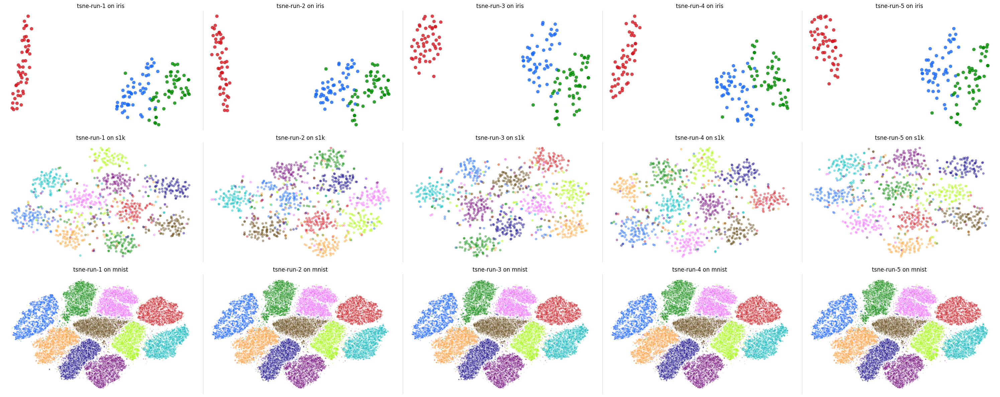

In [ ]:
experiment = Experiment(name="tsne-repeats-pca")

seeds = np.random.SeedSequence(42).generate_state(5)

for i, seed in enumerate(seeds, 1):
    experiment.add_method(
        ("tsne", {"initialization": "pca", "params": {"random_state": seed}}),
        name=f"tsne-run-{i}",
    )

experiment.add_datasets(["iris", "s1k", "mnist"])
experiment.run()
experiment.plot()

The small datasets show a surprisingly large change dependent on the random seed. However, MNIST is
a lot more stable. Practically speaking then, we probably don't have to worry too much about the
stochastic effects of PCA initialization on real-world data.

To prove that the effect is entirely from PCA and not a bug in my pipeline code (or you have
creeping doubts about stochasticity somehow creeping into other parts of the openTSNE code base),
here is the experiment repeated but splitting into three stages: PCA externally with a fixed seed,
t-SNE-style rescaling, and then using those coordinates directly with t-SNE embedding, which will
skip the initialization step. The seeds for this part are allowed to vary, but shouldn't be used
for anything.

[12:35:59] INFO     Running tsne-run-1 on iris                                      ]8;id=647569;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=446199;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:36:00] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=991738;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=728461;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=491845;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=635958;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=700349;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=25414;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Automatically determined negative gradient method `bh`                ]8;id=295117;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=817252;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:36:01] INFO     Running tsne-run-1 on s1k                                       ]8;id=740795;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=578286;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=72791;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=384682;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=820121;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=847165;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=497454;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=950259;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:36:05] INFO     Automatically determined negative gradient method `bh`                ]8;id=392292;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=388641;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:36:14] INFO     Running tsne-run-1 on mnist                                     ]8;id=443499;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=143683;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:36:17] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=581681;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=912565;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:36:20] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=130154;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=296646;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=890791;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=701647;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:36:51] INFO     Automatically determined negative gradient method `fft`               ]8;id=783202;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=235774;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:38:45] INFO     Running tsne-run-2 on iris                                      ]8;id=195428;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=99332;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=236759;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=490847;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=35933;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=184440;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=672773;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=760682;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:38:46] INFO     Automatically determined negative gradient method `bh`                ]8;id=225410;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=117852;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

           INFO     Running tsne-run-2 on s1k                                       ]8;id=256932;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=587207;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:38:47] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=685830;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=367571;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=626491;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=842367;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=469822;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=71967;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:38:50] INFO     Automatically determined negative gradient method `bh`                ]8;id=778240;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=541473;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:39:00] INFO     Running tsne-run-2 on mnist                                     ]8;id=316299;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=685250;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:39:03] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=383962;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=248015;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:39:06] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=333417;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=678867;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=162453;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=21964;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:39:35] INFO     Automatically determined negative gradient method `fft`               ]8;id=769776;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=474336;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:41:28] INFO     Running tsne-run-3 on iris                                      ]8;id=427534;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=936049;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=98311;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=593180;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=242729;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=127692;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=780207;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=221865;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:41:29] INFO     Automatically determined negative gradient method `bh`                ]8;id=998167;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=440642;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:41:30] INFO     Running tsne-run-3 on s1k                                       ]8;id=28727;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=254298;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=793348;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=107854;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=38085;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=980466;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=354414;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=35341;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:41:33] INFO     Automatically determined negative gradient method `bh`                ]8;id=440202;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=229211;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:41:43] INFO     Running tsne-run-3 on mnist                                     ]8;id=665025;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=215106;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:41:45] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=196560;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=905706;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:41:48] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=699303;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=921561;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=546629;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=801434;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:42:18] INFO     Automatically determined negative gradient method `fft`               ]8;id=898302;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=869603;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:44:15] INFO     Running tsne-run-4 on iris                                      ]8;id=784152;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=515846;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=315831;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=505437;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=76777;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=716963;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=607886;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=747311;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:44:16] INFO     Automatically determined negative gradient method `bh`                ]8;id=263157;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=988082;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:44:17] INFO     Running tsne-run-4 on s1k                                       ]8;id=394231;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=412027;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=415472;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=927992;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=871951;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=617150;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=14722;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=125997;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:44:21] INFO     Automatically determined negative gradient method `bh`                ]8;id=842024;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=796038;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:44:31] INFO     Running tsne-run-4 on mnist                                     ]8;id=44502;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=293176;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:44:33] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=183720;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=400187;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:44:37] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=991068;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=36564;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=715231;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=488261;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:45:06] INFO     Automatically determined negative gradient method `fft`               ]8;id=150045;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=540284;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:47:11] INFO     Running tsne-run-5 on iris                                      ]8;id=240509;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=281889;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=892475;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=729427;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=482376;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=476563;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=745092;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=717525;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:47:12] INFO     Automatically determined negative gradient method `bh`                ]8;id=223626;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=922586;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:47:13] INFO     Running tsne-run-5 on s1k                                       ]8;id=820985;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=841407;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=122353;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=442102;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=527603;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=152829;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=644465;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=439556;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:47:16] INFO     Automatically determined negative gradient method `bh`                ]8;id=154841;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=553984;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:47:26] INFO     Running tsne-run-5 on mnist                                     ]8;id=767754;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=924144;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:47:29] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=584203;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=246103;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:47:32] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=994483;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=869361;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=266127;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=730939;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:48:04] INFO     Automatically determined negative gradient method `fft`               ]8;id=811778;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=3272;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

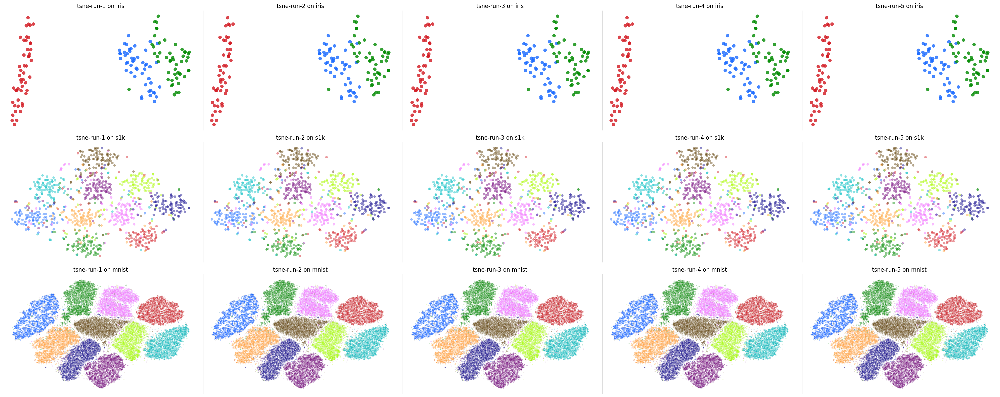

In [3]:
experiment = Experiment(name="tsne-repeats-pca-external")

seeds = np.random.SeedSequence(42).generate_state(5)

for i, seed in enumerate(seeds, 1):
    experiment.add_method(
        [
            pl.embedder(
                "pca",
                params={"random_state": 42},
            ),
            "tsne-rescale",
            ("tsne", {"params": {"random_state": seed}}),
        ],
        name=f"tsne-run-{i}",
    )

experiment.add_datasets(["iris", "s1k", "mnist"])
experiment.run()
experiment.plot()

As expected, consistency reigns.

## Random Repeats

Now let's see how we do with random initialization on a variety of datasets. For comparison with 
UMAP and PaCMAP see <https://github.com/jlmelville/drnb/blob/master/notebooks/embed-pipeline/pacmap-repeats.ipynb>.

[12:52:25] INFO     Running tsne-run-1 on curve2d                                   ]8;id=737536;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=41914;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:52:26] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=146722;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=631565;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=827088;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=126952;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=950966;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=997272;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:52:32] INFO     Automatically determined negative gradient method `bh`                ]8;id=963584;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=353405;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:52:43] INFO     Running tsne-run-1 on mammoth                                   ]8;id=210191;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=327554;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:52:44] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=534109;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=248217;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:52:46] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=413642;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=523173;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=26723;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=503569;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:53:04] INFO     Automatically determined negative gradient method `fft`               ]8;id=120158;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=802023;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:54:54] INFO     Running tsne-run-1 on scurvehole                                ]8;id=159370;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=547836;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=112376;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=452938;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=92605;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=396285;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=816647;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=841103;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:56:00] INFO     Automatically determined negative gradient method `bh`                ]8;id=650745;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=109967;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:58:05] INFO     Running tsne-run-1 on isoswiss                                  ]8;id=71015;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=245800;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=105986;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=398625;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=847775;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=928489;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=974534;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=267579;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:58:13] INFO     Automatically determined negative gradient method `fft`               ]8;id=529880;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=572184;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[12:59:39] INFO     Running tsne-run-1 on hierarchical                              ]8;id=219520;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=573994;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[12:59:41] INFO     Loading faiss with AVX2 support.                                   ]8;id=260434;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/faiss-1.9.0-py3.12.egg/faiss/loader.py\loader.py]8;;\:]8;id=307154;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/faiss-1.9.0-py3.12.egg/faiss/loader.py#110\110]8;;\

           INFO     Successfully loaded faiss with AVX2 support.                       ]8;id=286598;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/faiss-1.9.0-py3.12.egg/faiss/loader.py\loader.py]8;;\:]8;id=492151;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/faiss-1.9.0-py3.12.egg/faiss/loader.py#112\112]8;;\

[12:59:42] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=948936;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=528251;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[12:59:44] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=752066;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=413584;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=802813;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=630538;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:00:04] INFO     Automatically determined negative gradient method `fft`               ]8;id=597594;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=311689;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:01:09] INFO     Running tsne-run-1 on spheres                                   ]8;id=482645;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=718875;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:01:10] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=902679;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=5836;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=417455;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=877622;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=921337;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=955429;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:01:15] INFO     Automatically determined negative gradient method `fft`               ]8;id=146648;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=372155;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:01:28] INFO     Running tsne-run-1 on coil20                                    ]8;id=725637;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=723651;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:01:29] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=55914;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=527850;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=345683;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=349733;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=101323;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=48428;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:01:36] INFO     Automatically determined negative gradient method `bh`                ]8;id=59512;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=400938;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:01:49] INFO     Running tsne-run-1 on coil100                                   ]8;id=6532;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=303744;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:02:02] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=780914;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=386813;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=672046;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=850255;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=739813;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=999885;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:02:54] INFO     Automatically determined negative gradient method `bh`                ]8;id=401757;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=911080;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:04:20] INFO     Running tsne-run-1 on mnist                                     ]8;id=303155;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=483896;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:04:21] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=49143;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=980538;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:04:25] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=20030;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=952961;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=602308;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=722961;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:04:55] INFO     Automatically determined negative gradient method `fft`               ]8;id=782130;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=427704;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:06:51] INFO     Running tsne-run-1 on fashion                                   ]8;id=802797;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=626801;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:06:54] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=327304;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=545476;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:06:57] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=299531;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=515585;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=652605;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=232810;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:07:28] INFO     Automatically determined negative gradient method `fft`               ]8;id=614088;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=391439;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:09:15] INFO     Running tsne-run-1 on ng20pacmap                                ]8;id=651151;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=682590;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:09:16] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=948293;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=567973;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=12827;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=658228;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=419720;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=682088;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:09:26] INFO     Automatically determined negative gradient method `fft`               ]8;id=585804;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=266908;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:10:23] INFO     Running tsne-run-1 on macosko2015                               ]8;id=387818;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=618338;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:10:29] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=407699;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=607445;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:10:31] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=753352;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=96907;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=465496;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=802373;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:10:52] INFO     Automatically determined negative gradient method `fft`               ]8;id=609692;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=639452;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:11:35] INFO     Running tsne-run-1 on tasic2018                                 ]8;id=655505;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=947436;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:11:39] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=552552;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=879530;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=403696;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=617174;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=542639;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=772807;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:11:50] INFO     Automatically determined negative gradient method `fft`               ]8;id=120109;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=90365;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:12:40] INFO     Running tsne-run-1 on lamanno2020                               ]8;id=468627;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=405653;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=224752;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=404489;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=830002;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=723332;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=15362;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=887062;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:13:06] INFO     Automatically determined negative gradient method `bh`                ]8;id=366077;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=568707;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:13:52] INFO     Running tsne-run-1 on kazer                                     ]8;id=703357;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=738256;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:13:53] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=325648;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=395986;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:13:55] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=69092;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=462368;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=688251;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=76573;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:14:18] INFO     Automatically determined negative gradient method `fft`               ]8;id=377259;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=761639;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:15:36] INFO     Running tsne-run-1 on stuart                                    ]8;id=812349;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=792794;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:15:37] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=191648;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=185339;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:15:38] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=565711;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=165573;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=389751;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=62979;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:15:54] INFO     Automatically determined negative gradient method `fft`               ]8;id=631228;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=931734;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:16:54] INFO     Running tsne-run-1 on kang                                      ]8;id=709410;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=544021;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=907103;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=409470;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:16:55] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=422760;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=626194;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=813089;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=939085;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:17:03] INFO     Automatically determined negative gradient method `fft`               ]8;id=807018;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=457811;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:17:33] INFO     Running tsne-run-2 on curve2d                                   ]8;id=914834;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=240342;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=340490;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=43302;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=314965;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=730047;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=837741;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=634585;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:17:39] INFO     Automatically determined negative gradient method `bh`                ]8;id=905427;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=269820;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:17:51] INFO     Running tsne-run-2 on mammoth                                   ]8;id=369239;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=867926;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:17:52] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=863362;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=856492;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:17:54] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=490780;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=136605;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=87449;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=548782;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:18:13] INFO     Automatically determined negative gradient method `fft`               ]8;id=638799;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=980623;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:20:00] INFO     Running tsne-run-2 on scurvehole                                ]8;id=718667;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=415044;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=975084;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=965663;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=995464;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=631918;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=711350;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=623868;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:21:11] INFO     Automatically determined negative gradient method `bh`                ]8;id=411831;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=717716;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:23:19] INFO     Running tsne-run-2 on isoswiss                                  ]8;id=184223;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=925858;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=445832;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=571356;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:23:20] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=401843;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=681879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=328832;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=190639;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:23:29] INFO     Automatically determined negative gradient method `fft`               ]8;id=204441;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=385530;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:24:56] INFO     Running tsne-run-2 on hierarchical                              ]8;id=365863;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=157608;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:24:58] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=763269;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=959117;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:25:00] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=600422;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=179092;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=93705;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=886199;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:25:20] INFO     Automatically determined negative gradient method `fft`               ]8;id=418661;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=181511;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:26:28] INFO     Running tsne-run-2 on spheres                                   ]8;id=264434;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=790338;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=677222;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=785575;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=300466;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=848436;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=123725;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=497730;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:26:34] INFO     Automatically determined negative gradient method `fft`               ]8;id=60640;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=51616;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:26:47] INFO     Running tsne-run-2 on coil20                                    ]8;id=219774;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=532876;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:26:48] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=932902;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=611001;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=391528;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=451808;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=504170;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=466532;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:26:56] INFO     Automatically determined negative gradient method `bh`                ]8;id=819652;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=946567;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:27:09] INFO     Running tsne-run-2 on coil100                                   ]8;id=838869;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=169122;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:27:18] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=970104;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=734978;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=366715;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=986161;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=554943;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=195469;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:28:10] INFO     Automatically determined negative gradient method `bh`                ]8;id=624833;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=207409;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:29:36] INFO     Running tsne-run-2 on mnist                                     ]8;id=888378;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=867524;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:29:38] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=198542;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=740441;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:29:41] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=760312;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=788075;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=121456;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=652761;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:30:10] INFO     Automatically determined negative gradient method `fft`               ]8;id=588607;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=105277;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:31:58] INFO     Running tsne-run-2 on fashion                                   ]8;id=205925;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=19919;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:32:00] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=895463;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=540791;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:32:03] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=186692;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=122337;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=142323;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=968541;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:32:34] INFO     Automatically determined negative gradient method `fft`               ]8;id=275695;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=965311;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:34:27] INFO     Running tsne-run-2 on ng20pacmap                                ]8;id=172011;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=124753;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=762214;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=434790;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:34:28] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=195171;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=986235;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=589500;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=46100;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:34:37] INFO     Automatically determined negative gradient method `fft`               ]8;id=982852;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=14915;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:35:34] INFO     Running tsne-run-2 on macosko2015                               ]8;id=391101;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=137733;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:35:38] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=717819;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=368099;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:35:39] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=811841;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=972025;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=502213;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=520113;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:36:01] INFO     Automatically determined negative gradient method `fft`               ]8;id=956257;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=268321;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:36:44] INFO     Running tsne-run-2 on tasic2018                                 ]8;id=100848;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=562669;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:36:46] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=59216;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=497879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:36:47] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=462562;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=342381;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=985321;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=253641;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:36:57] INFO     Automatically determined negative gradient method `fft`               ]8;id=629792;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=66;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:37:45] INFO     Running tsne-run-2 on lamanno2020                               ]8;id=95207;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=131012;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:37:46] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=553031;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=840719;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=885625;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=139448;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=229333;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=973774;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:38:11] INFO     Automatically determined negative gradient method `bh`                ]8;id=438123;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=656589;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:38:58] INFO     Running tsne-run-2 on kazer                                     ]8;id=268934;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=434676;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:38:59] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=263300;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=274860;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:39:00] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=388948;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=881554;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=333497;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=92441;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:39:24] INFO     Automatically determined negative gradient method `fft`               ]8;id=405517;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=178677;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:40:42] INFO     Running tsne-run-2 on stuart                                    ]8;id=321687;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=938325;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=759131;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=171175;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:40:43] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=475517;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=970909;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=409405;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=981491;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:40:58] INFO     Automatically determined negative gradient method `fft`               ]8;id=687002;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=481019;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:41:52] INFO     Running tsne-run-2 on kang                                      ]8;id=910578;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=347086;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=450235;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=449149;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=147783;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=208401;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=418183;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=968782;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:42:00] INFO     Automatically determined negative gradient method `fft`               ]8;id=426547;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=149202;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:42:29] INFO     Running tsne-run-3 on curve2d                                   ]8;id=853884;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=18035;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=333107;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=46240;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=848843;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=557502;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=397359;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=237351;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:42:35] INFO     Automatically determined negative gradient method `bh`                ]8;id=621052;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=57606;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:42:46] INFO     Running tsne-run-3 on mammoth                                   ]8;id=106565;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=79234;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:42:47] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=912023;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=28846;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:42:48] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=766375;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=341764;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=275657;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=363098;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:43:06] INFO     Automatically determined negative gradient method `fft`               ]8;id=356976;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=862756;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:45:04] INFO     Running tsne-run-3 on scurvehole                                ]8;id=303912;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=479284;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=192025;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=134949;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=952034;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=319330;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=779358;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=661511;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:46:11] INFO     Automatically determined negative gradient method `bh`                ]8;id=990124;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=552134;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:48:16] INFO     Running tsne-run-3 on isoswiss                                  ]8;id=515329;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=488731;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:48:17] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=473116;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=990753;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=694333;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=724996;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=694186;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=687953;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:48:25] INFO     Automatically determined negative gradient method `fft`               ]8;id=965217;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=694476;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:49:45] INFO     Running tsne-run-3 on hierarchical                              ]8;id=311195;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=502077;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:49:47] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=724598;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=373681;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:49:49] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=867979;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=247912;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=158381;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=278562;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:50:10] INFO     Automatically determined negative gradient method `fft`               ]8;id=457761;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=809770;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:51:16] INFO     Running tsne-run-3 on spheres                                   ]8;id=319824;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=400825;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=767653;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=731702;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:51:17] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=692169;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=436121;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=631217;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=740300;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:51:22] INFO     Automatically determined negative gradient method `fft`               ]8;id=539749;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=655708;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:51:34] INFO     Running tsne-run-3 on coil20                                    ]8;id=207119;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=748332;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:51:35] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=722658;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=390520;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=238065;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=524927;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=630123;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=675795;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:51:42] INFO     Automatically determined negative gradient method `bh`                ]8;id=211514;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=499346;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:51:55] INFO     Running tsne-run-3 on coil100                                   ]8;id=542991;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=11071;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:52:03] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=933701;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=756474;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:52:04] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=782191;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=201752;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=709545;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=687181;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:52:56] INFO     Automatically determined negative gradient method `bh`                ]8;id=158879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=268594;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:54:22] INFO     Running tsne-run-3 on mnist                                     ]8;id=603514;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=648346;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:54:24] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=301747;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=727579;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:54:27] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=652674;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=129655;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=4385;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=765128;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:54:56] INFO     Automatically determined negative gradient method `fft`               ]8;id=535703;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=245405;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:56:47] INFO     Running tsne-run-3 on fashion                                   ]8;id=58350;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=750142;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[13:56:49] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=883094;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=661983;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:56:52] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=119368;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=35322;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=227530;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=59548;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:57:24] INFO     Automatically determined negative gradient method `fft`               ]8;id=225887;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=558961;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:59:15] INFO     Running tsne-run-3 on ng20pacmap                                ]8;id=306875;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=413845;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=841060;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=353768;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[13:59:16] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=279862;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=105771;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=218217;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=177356;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[13:59:25] INFO     Automatically determined negative gradient method `fft`               ]8;id=650668;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=669146;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:00:24] INFO     Running tsne-run-3 on macosko2015                               ]8;id=364613;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=315590;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:00:28] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=929568;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=780986;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:00:29] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=469369;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=874228;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=617537;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=466384;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:00:51] INFO     Automatically determined negative gradient method `fft`               ]8;id=983315;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=271583;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:01:35] INFO     Running tsne-run-3 on tasic2018                                 ]8;id=978421;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=656327;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:01:37] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=920095;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=440254;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=382374;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=963009;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=284922;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=405759;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:01:48] INFO     Automatically determined negative gradient method `fft`               ]8;id=866956;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=515270;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:02:36] INFO     Running tsne-run-3 on lamanno2020                               ]8;id=874057;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=410351;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=773919;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=370302;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:02:37] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=781262;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=154559;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=720842;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=319869;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:03:03] INFO     Automatically determined negative gradient method `bh`                ]8;id=421824;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=63503;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:03:49] INFO     Running tsne-run-3 on kazer                                     ]8;id=276733;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=721923;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:03:50] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=585952;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=432837;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:03:52] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=624742;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=967172;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=654110;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=984094;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:04:15] INFO     Automatically determined negative gradient method `fft`               ]8;id=534274;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=939238;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:05:35] INFO     Running tsne-run-3 on stuart                                    ]8;id=997338;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=740970;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:05:36] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=909166;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=510072;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=46522;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=867646;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=337461;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=199514;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:05:51] INFO     Automatically determined negative gradient method `fft`               ]8;id=305060;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=598967;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:06:44] INFO     Running tsne-run-3 on kang                                      ]8;id=371962;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=68462;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=75637;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=612174;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:06:45] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=906192;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=316226;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=554492;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=817965;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:06:52] INFO     Automatically determined negative gradient method `fft`               ]8;id=243055;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=578693;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:07:21] INFO     Running tsne-run-4 on curve2d                                   ]8;id=476547;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=803731;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=832011;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=898148;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=473747;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=418620;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=67605;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=675942;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:07:27] INFO     Automatically determined negative gradient method `bh`                ]8;id=609360;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=379106;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:07:39] INFO     Running tsne-run-4 on mammoth                                   ]8;id=591222;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=426622;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:07:40] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=200879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=775035;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:07:41] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=747797;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=226656;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=793738;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=380831;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:07:59] INFO     Automatically determined negative gradient method `fft`               ]8;id=808158;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=517271;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:09:47] INFO     Running tsne-run-4 on scurvehole                                ]8;id=802464;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=717206;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=432577;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=446764;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=174815;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=176027;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=221060;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=848743;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:10:54] INFO     Automatically determined negative gradient method `bh`                ]8;id=216722;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=716835;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:13:00] INFO     Running tsne-run-4 on isoswiss                                  ]8;id=165831;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=550093;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=211469;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=563117;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:13:01] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=631555;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=116338;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=20367;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=140687;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:13:08] INFO     Automatically determined negative gradient method `fft`               ]8;id=126423;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=409087;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:14:26] INFO     Running tsne-run-4 on hierarchical                              ]8;id=265041;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=391612;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:14:28] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=656015;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=849155;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:14:30] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=603512;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=626102;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=143706;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=748876;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:14:50] INFO     Automatically determined negative gradient method `fft`               ]8;id=782021;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=812748;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:15:55] INFO     Running tsne-run-4 on spheres                                   ]8;id=317278;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=726477;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=854170;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=905600;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=167377;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=195009;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=491919;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=775997;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:16:01] INFO     Automatically determined negative gradient method `fft`               ]8;id=267246;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=18958;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:16:14] INFO     Running tsne-run-4 on coil20                                    ]8;id=284699;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=501052;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=738131;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=286915;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=288502;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=655470;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=150530;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=920720;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:16:22] INFO     Automatically determined negative gradient method `bh`                ]8;id=789475;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=953927;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:16:35] INFO     Running tsne-run-4 on coil100                                   ]8;id=291090;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=442689;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:16:43] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=278823;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=44253;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=691942;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=374944;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=870417;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=67604;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:17:35] INFO     Automatically determined negative gradient method `bh`                ]8;id=947163;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=413359;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:19:00] INFO     Running tsne-run-4 on mnist                                     ]8;id=453308;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=817736;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:19:01] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=923657;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=219596;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:19:05] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=76961;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=505369;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=588277;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=750785;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:19:33] INFO     Automatically determined negative gradient method `fft`               ]8;id=373090;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=388174;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:21:26] INFO     Running tsne-run-4 on fashion                                   ]8;id=67442;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=961843;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:21:28] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=857058;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=889562;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:21:31] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=871010;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=312126;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=204333;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=96080;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:22:02] INFO     Automatically determined negative gradient method `fft`               ]8;id=997683;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=704765;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:23:55] INFO     Running tsne-run-4 on ng20pacmap                                ]8;id=26335;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=898493;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:23:56] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=699279;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=433879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=252526;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=125175;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=38680;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=9967;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:24:06] INFO     Automatically determined negative gradient method `fft`               ]8;id=819977;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=845268;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:25:02] INFO     Running tsne-run-4 on macosko2015                               ]8;id=714074;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=793180;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:25:05] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=664270;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=970949;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:25:07] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=875706;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=244006;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=938838;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=828785;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:25:29] INFO     Automatically determined negative gradient method `fft`               ]8;id=860355;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=513665;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:26:12] INFO     Running tsne-run-4 on tasic2018                                 ]8;id=192902;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=861531;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:26:14] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=361879;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=179956;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:26:15] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=583923;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=641698;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=785839;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=919340;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:26:25] INFO     Automatically determined negative gradient method `fft`               ]8;id=152772;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=631271;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:27:15] INFO     Running tsne-run-4 on lamanno2020                               ]8;id=733551;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=115674;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:27:16] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=587881;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=83475;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=185851;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=927144;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=852023;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=692175;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:27:42] INFO     Automatically determined negative gradient method `bh`                ]8;id=179482;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=657719;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:28:27] INFO     Running tsne-run-4 on kazer                                     ]8;id=805366;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=790711;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:28:28] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=253859;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=946952;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:28:29] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=666379;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=391723;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=780717;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=264290;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:28:53] INFO     Automatically determined negative gradient method `fft`               ]8;id=658516;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=952958;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:30:07] INFO     Running tsne-run-4 on stuart                                    ]8;id=778032;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=559762;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=555212;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=771385;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:30:08] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=475423;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=992848;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=746482;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=165316;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:30:23] INFO     Automatically determined negative gradient method `fft`               ]8;id=516323;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=638788;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:31:13] INFO     Running tsne-run-4 on kang                                      ]8;id=133243;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=661525;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:31:14] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=760760;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=625649;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=565196;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=797053;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=183853;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=840079;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:31:22] INFO     Automatically determined negative gradient method `fft`               ]8;id=15627;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=402603;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:31:55] INFO     Running tsne-run-5 on curve2d                                   ]8;id=541525;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=711982;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=762044;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=865981;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=430042;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=439754;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=305871;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=734938;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:32:01] INFO     Automatically determined negative gradient method `bh`                ]8;id=575287;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=37631;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:32:12] INFO     Running tsne-run-5 on mammoth                                   ]8;id=7072;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=132011;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:32:13] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=239634;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=441537;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:32:14] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=931810;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=641882;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=780669;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=910643;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:32:32] INFO     Automatically determined negative gradient method `fft`               ]8;id=384422;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=338681;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:34:24] INFO     Running tsne-run-5 on scurvehole                                ]8;id=135643;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=466376;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=773970;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=802357;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:34:25] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=901511;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=812003;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=195319;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=588327;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:35:31] INFO     Automatically determined negative gradient method `bh`                ]8;id=832682;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=423871;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:37:37] INFO     Running tsne-run-5 on isoswiss                                  ]8;id=623064;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=754618;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=903192;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=410745;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:37:38] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=320726;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=795493;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=63575;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=740211;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:37:45] INFO     Automatically determined negative gradient method `fft`               ]8;id=661180;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=458129;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:39:21] INFO     Running tsne-run-5 on hierarchical                              ]8;id=168542;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=878991;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:39:24] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=661566;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=702287;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:39:26] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=562403;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=359227;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=437371;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=339871;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:39:46] INFO     Automatically determined negative gradient method `fft`               ]8;id=453139;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=82463;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:40:51] INFO     Running tsne-run-5 on spheres                                   ]8;id=940857;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=651593;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=261038;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=483090;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=240206;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=968238;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=773211;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=270973;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:40:56] INFO     Automatically determined negative gradient method `fft`               ]8;id=545252;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=815134;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:41:08] INFO     Running tsne-run-5 on coil20                                    ]8;id=519954;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=887263;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:41:09] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=289212;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=800249;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=220030;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=489297;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=575713;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=302666;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:41:16] INFO     Automatically determined negative gradient method `bh`                ]8;id=744953;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=81742;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:41:29] INFO     Running tsne-run-5 on coil100                                   ]8;id=402699;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=745838;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:41:38] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=402443;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=470759;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=173183;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=645030;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=915404;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=377596;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:42:31] INFO     Automatically determined negative gradient method `bh`                ]8;id=242173;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=793287;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:43:55] INFO     Running tsne-run-5 on mnist                                     ]8;id=948443;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=706673;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:43:57] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=142921;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=625475;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:44:00] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=813692;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=665945;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=503690;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=372682;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:44:29] INFO     Automatically determined negative gradient method `fft`               ]8;id=575304;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=93615;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:46:18] INFO     Running tsne-run-5 on fashion                                   ]8;id=468531;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=623564;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:46:20] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=240806;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=697646;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:46:23] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=591768;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=489606;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=287168;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=990573;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:46:54] INFO     Automatically determined negative gradient method `fft`               ]8;id=500984;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=893988;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:48:40] INFO     Running tsne-run-5 on ng20pacmap                                ]8;id=596462;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=703385;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=343693;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=299148;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:48:41] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=387253;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=42864;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=865061;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=735269;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:48:51] INFO     Automatically determined negative gradient method `fft`               ]8;id=763822;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=549223;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:49:45] INFO     Running tsne-run-5 on macosko2015                               ]8;id=731251;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=478265;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:49:49] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=421927;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=291452;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:49:51] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=900557;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=926062;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=805140;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=498804;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:50:12] INFO     Automatically determined negative gradient method `fft`               ]8;id=421650;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=422957;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:50:56] INFO     Running tsne-run-5 on tasic2018                                 ]8;id=6722;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=133361;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:50:58] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=232264;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=1727;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:50:59] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=753919;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=294920;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=444733;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=75528;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:51:09] INFO     Automatically determined negative gradient method `fft`               ]8;id=867098;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=333620;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:51:57] INFO     Running tsne-run-5 on lamanno2020                               ]8;id=80198;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=434514;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:51:58] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=426286;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=400185;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

           INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=687930;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=661332;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `bh`                ]8;id=106794;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=542763;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:52:24] INFO     Automatically determined negative gradient method `bh`                ]8;id=823300;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=5506;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:53:08] INFO     Running tsne-run-5 on kazer                                     ]8;id=877173;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=578486;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

[14:53:09] INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=380276;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=656604;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:53:11] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=473143;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=38676;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=396470;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=378826;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:53:34] INFO     Automatically determined negative gradient method `fft`               ]8;id=678812;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=553163;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:54:54] INFO     Running tsne-run-5 on stuart                                    ]8;id=735747;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=807200;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=312792;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=311014;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:54:55] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=132393;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=290852;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=36197;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=137855;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:55:10] INFO     Automatically determined negative gradient method `fft`               ]8;id=525901;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=582;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:56:01] INFO     Running tsne-run-5 on kang                                      ]8;id=661563;file:///home/james/dev/drnb3/src/drnb/experiment.py\experiment.py]8;;\:]8;id=860352;file:///home/james/dev/drnb3/src/drnb/experiment.py#67\67]8;;\

           INFO     KNN index provided. Ignoring KNN-related parameters.             ]8;id=727413;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py\affinity.py]8;;\:]8;id=176365;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/affinity.py#190\190]8;;\

[14:56:02] INFO     Precomputed affinities provided. Ignoring perplexity-related        ]8;id=179694;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=797532;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#1340\1340]8;;\
                    parameters.                                                                     

           INFO     Automatically determined negative gradient method `fft`               ]8;id=518923;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=324808;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

[14:56:09] INFO     Automatically determined negative gradient method `fft`               ]8;id=604426;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py\tsne.py]8;;\:]8;id=416732;file:///home/james/dev/drnb3/.venv/lib/python3.12/site-packages/openTSNE/tsne.py#53\53]8;;\

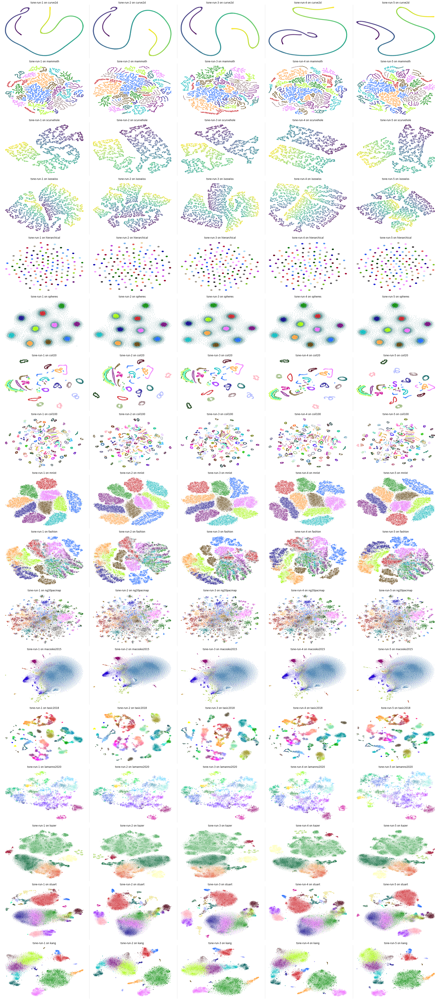

In [6]:
experiment = Experiment(name="tsne-repeats-random")

seeds = np.random.SeedSequence(42).generate_state(5)

for i, seed in enumerate(seeds, 1):
    experiment.add_method(
        ("tsne", {"initialization": "random", "params": {"random_state": seed}}),
        name=f"tsne-run-{i}",
    )

experiment.add_datasets(
    [
        "curve2d",
        "mammoth",
        "scurvehole",
        "isoswiss",
        "hierarchical",
        "spheres",
        "coil20",
        "coil100",
        "mnist",
        "fashion",
        "ng20pacmap",
        "macosko2015",
        "tasic2018",
        "lamanno2020",
        "kazer",
        "stuart",
        "kang",
    ]
)
experiment.run()
experiment.plot()

The results seem quite clear: with default settings and random initialization, there are obvious 
differences between the layouts. Local structures are preserved, but overall arrangement
and orientation of clusters differ. It could certainly be the case that there isn't a lot of value
to the more "global" layout that spectral of PCA-based initialization provides, but it's hard to
argue that these results are converging to the same map.